# Diffusion Model Training Script

## Install Required Packages
This section installs the `datasets` library, which is essential for loading and processing datasets.

In [1]:
!pip install datasets

## Import Necessary Libraries
This block imports various libraries required for the script, including PyTorch, torchvision, and matplotlib, among others.

In [2]:
import torch
import math
import torchvision
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torch import nn
from datasets import Features, Image, ClassLabel, load_dataset
from torch.optim import Adam
from torch.utils.data import DataLoader
from torchvision import transforms
import numpy as np

## Load and Transform Dataset

## Defining Features and Loading the Dataset:

The code specifies the dataset features, including image decoding and class labels.
It then loads the WikiArt dataset using these defined features.

## Applying Transformations:

A series of transformations are defined, including resizing images to 256x256 pixels and converting them to PyTorch tensors.
Transforming the Dataset:

A function is created to apply the defined transformations to each image in the dataset.
The transformations are then applied to the entire training dataset, ensuring that all images are resized and converted to tensors.


In [3]:
# Define features and load dataset
class_names = ['image']
features = Features({
    'image': Image(decode=True, id=None),
    'label': ClassLabel(names=[
        '625819a92a2466ab6181a2fb5271ae99c740b4f0e4b9bc97bcfa01ef4ed9666f',
        '739a87d55867610f9341b5706e0702effaca6404b58a85184530e97674925c11',
        '912b0ea8f91a77c03100a11b064c6352c96b157402b302f1d4e2fdd0b19ca0da',
        'c130f98c73856f51a8a5d53d5566171b4f3b2b64b733b9392b3a4c4387af0208',
        'ca0306348357abce2f22db92a9d60f3c7d65a4b6a94e9f8b596b33c0bb41d22c'], id=None)
})
dataset = load_dataset("haganelego/wikiart_256x256", features=features)

# Apply transformations to the dataset
transform_pipeline = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to 256x256 pixels
    transforms.ToTensor()  # Convert PIL Image to Tensor
])

# Apply transformations to the image
def apply_transformations(batch):
    batch['image'] = transform_pipeline(batch['image'])
    return batch

# Apply transformation to entire training dataset
train_dataset = dataset['train'].map(apply_transformations)

# Ensure train_dataset is a list of tensors
train_dataset.set_format(type='torch', columns=['image', 'label'])

Resolving data files:   0%|          | 0/23 [00:00<?, ?it/s]

Generating train split: 0 examples [00:00, ? examples/s]

Map:   0%|          | 0/13346 [00:00<?, ? examples/s]

## Defining the Model Architecture



## Block Class
### Purpose: 
    Handles upsampling or downsampling with time embeddings.
### Key Components:
- Convolutions: conv1 and conv2 for initial and subsequent processing.

- Transform: ConvTranspose2d for upsampling or Conv2d for downsampling.

- Batch Normalization: bnorm1 and bnorm2.

- ReLU Activation.

- Time Embedding: Adds temporal information.

- Forward Method: Applies convolutions, adds time embedding, normalizes, and transforms the input.


In [4]:
# Define the model architecture
class UNetBlock(nn.Module):
    def __init__(self, in_channels, out_channels, time_embedding_dim, is_upsampling=False):
        super().__init__()
        self.time_mlp = nn.Linear(time_embedding_dim, out_channels)  # Linear layer for time embedding
        if is_upsampling:
            self.conv1 = nn.Conv2d(2 * in_channels, out_channels, 3, padding=1)  # Convolution for upsampling
            self.transform = nn.ConvTranspose2d(out_channels, out_channels, 4, 2, 1)  # Transpose convolution for upsampling
        else:
            self.conv1 = nn.Conv2d(in_channels, out_channels, 3, padding=1)  # Convolution for downsampling
            self.transform = nn.Conv2d(out_channels, out_channels, 4, 2, 1)  # Convolution for downsampling
        self.conv2 = nn.Conv2d(out_channels, out_channels, 3, padding=1)  # Second convolution layer
        self.batch_norm1 = nn.BatchNorm2d(out_channels)  # Batch normalization layer 1
        self.batch_norm2 = nn.BatchNorm2d(out_channels)  # Batch normalization layer 2
        self.activation = nn.ReLU()  # ReLU activation function
        
    def forward(self, x, time_embedding):
        hidden_state = self.batch_norm1(self.activation(self.conv1(x)))  # Apply first convolution, ReLU, and batch normalization
        time_emb = self.activation(self.time_mlp(time_embedding))  # Apply time embedding and ReLU
        time_emb = time_emb[(..., ) + (None, ) * 2]  # Reshape time embedding
        hidden_state = hidden_state + time_emb  # Add time embedding to hidden state
        hidden_state = self.batch_norm2(self.activation(self.conv2(hidden_state)))  # Apply second convolution, ReLU, and batch normalization
        return self.transform(hidden_state)  # Apply transformation (up/down sampling)


## SinusoidalPositionEmbeddings Class
### Purpose: 
    Creates sinusoidal embeddings for time steps.
## Key Process:
- Generates sine and cosine embeddings.
- Concatenates them to form the position embeddings.

In [5]:
class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, embedding_dim):
        super().__init__()
        self.embedding_dim = embedding_dim  # Dimension of embeddings

    def forward(self, time):
        device = time.device
        half_dim = self.embedding_dim // 2  # Half dimension for sine and cosine embeddings
        embeddings_scale = math.log(10000) / (half_dim - 1)  # Calculate scaling factor
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings_scale)  # Compute embeddings
        embeddings = time[:, None] * embeddings[None, :]  # Scale embeddings by time
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)  # Concatenate sine and cosine embeddings
        return embeddings

## SimpleUnet Class
### Purpose: 
    Implements a simplified UNet architecture with time embeddings.
### Key Components:
- Time Embeddings: SinusoidalPositionEmbeddings followed by a linear layer and ReLU.
- Convolutions: Initial convolution conv0 and final output layer output.
- Downsampling Blocks: downs, a list of Block modules for downsampling.
- Upsampling Blocks: ups, a list of Block modules for upsampling.
- Forward Method:
  - Time Embedding: Compute embeddings for the input time step.
- Processing:
  - Initial Convolution: Apply conv0.
  - Downsampling: Pass through downs blocks, storing intermediate outputs (residuals).
  - Upsampling: Pass through ups blocks, concatenating with residuals.
- Output: Generate final image using the output layer.

In [6]:
class SimpleUnet(nn.Module):
    def __init__(self):
        super().__init__()
        image_channels = 3  # Number of image channels (RGB)
        down_channels = (64, 128, 256, 512, 1024)  # Channels for downsampling layers
        up_channels = (1024, 512, 256, 128, 64)  # Channels for upsampling layers
        output_dim = 3  # Output dimension (RGB)
        time_embedding_dim = 32  # Dimension for time embeddings

        self.time_mlp = nn.Sequential(
            SinusoidalPositionEmbeddings(time_embedding_dim),  # Sinusoidal position embeddings
            nn.Linear(time_embedding_dim, time_embedding_dim),  # Linear layer
            nn.ReLU()  # ReLU activation function
        )
        
        self.initial_conv = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)  # Initial convolution layer
        self.downsample_blocks = nn.ModuleList([UNetBlock(down_channels[i], down_channels[i+1], time_embedding_dim) 
                                                for i in range(len(down_channels) - 1)])  # List of downsampling blocks
        self.upsample_blocks = nn.ModuleList([UNetBlock(up_channels[i], up_channels[i+1], time_embedding_dim, is_upsampling=True) 
                                              for i in range(len(up_channels) - 1)])  # List of upsampling blocks
        self.output_conv = nn.Conv2d(up_channels[-1], output_dim, 1)  # Output convolution layer

    def forward(self, x, timestep):
        time_emb = self.time_mlp(timestep)  # Get time embedding
        x = self.initial_conv(x)  # Apply initial convolution
        residuals = []
        for down_block in self.downsample_blocks:
            x = down_block(x, time_emb)  # Apply downsampling block
            residuals.append(x)  # Store residual for skip connection
        for up_block in self.upsample_blocks:
            residual_x = residuals.pop()  # Get corresponding residual
            x = torch.cat((x, residual_x), dim=1)  # Concatenate residual with current tensor
            x = up_block(x, time_emb)  # Apply upsampling block
        return self.output_conv(x)  # Return output


## Beta Schedule and Diffusion Parameters
## Cosine Beta Schedule:

### Purpose: 
    Computes the schedule for betas and cumulative alphas based on a cosine function.
### Key Steps:
- Generate linearly spaced time steps.
- Compute cumulative alphas using a cosine function.
- Normalize alphas and calculate betas.
- Output: Returns betas and alphas_cumprod.

### Parameter Initialization:
- Timesteps (T): Number of time steps for diffusion.
- Betas and Alphas: Computed using the cosine schedule.
### Other Parameters:
- sqrt_recip_alphas: Square root of the reciprocal of alphas.
- sqrt_one_minus_alphas_cumprod: Square root of one minus cumulative alphas.
- posterior_variance: Variance used in the reverse process.


## Helper Functions
### forward_diffusion_sample:
### Purpose: 
    Generates a noisy image by adding noise to the original image.
### Key Steps:
- Generate random noise.
- Retrieve cumulative alphas and their complements for the given time step.
- Combine image with noise using these values.
- Output: Returns the noisy image and the noise added.

## get_index_from_list:
### Purpose: 
    Retrieves values from a list based on time indices.
### Key Steps:
- Gathers values corresponding to time indices.
- Reshapes the output to match the input's shape.

## Loss Function
### get_loss:
### Purpose: 
    Computes the loss between actual noise and the model's predicted noise.
### Key Steps:
- Generate a noisy image using forward_diffusion_sample.
- Predict noise using the model.
- Calculate the L1 loss between actual and predicted noise.

In [7]:
# Define the beta schedule and related parameters
def cosine_beta_schedule(num_timesteps, s=0.008):
    steps = num_timesteps + 1
    linspace = torch.linspace(0, num_timesteps, steps)  # Generate linearly spaced steps
    alphas_cumprod = torch.cos((linspace / num_timesteps + s) / (1 + s) * math.pi * 0.5) ** 2  # Compute cumulative alphas
    alphas_cumprod = alphas_cumprod / alphas_cumprod[0]  # Normalize cumulative alphas
    betas = 1 - (alphas_cumprod[1:] / alphas_cumprod[:-1])  # Compute betas from cumulative alphas
    alphas_cumprod = alphas_cumprod[1:]  # Remove initial value
    return betas, alphas_cumprod  # Return betas and cumulative alphas

num_timesteps = 200  # Number of timesteps
betas, alphas_cumprod = cosine_beta_schedule(num_timesteps)  # Compute beta schedule
sqrt_recip_alphas = torch.sqrt(1.0 / (1.0 - betas))  # Compute square root of reciprocal alphas
sqrt_one_minus_alphas_cumprod = torch.sqrt(1.0 - alphas_cumprod) 
posterior_variance = betas * (1.0 - alphas_cumprod) / (1.0 - alphas_cumprod)  # Compute posterior variance

# Define helper functions
def forward_diffusion_sample(x_0, t, device):
    noise = torch.randn_like(x_0)  # Generate random noise
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_one_minus_alphas_cumprod, t, x_0.shape)  # Get sqrt_alphas_cumprod for t
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(sqrt_one_minus_alphas_cumprod, t, x_0.shape)  # Get sqrt_one_minus_alphas_cumprod for t
    x_noisy = sqrt_alphas_cumprod_t * x_0 + sqrt_one_minus_alphas_cumprod_t * noise  # Add noise to image
    return x_noisy, noise  # Return noisy image and noise

def get_index_from_list(values, t, shape):
    batch_size = t.shape[0]
    out = values.gather(-1, t.cpu())  # Gather values for indices t
    return out.reshape(batch_size, *((1,) * (len(shape) - 1))).to(t.device)  # Reshape output to match input shape

# Loss function
def compute_loss(model, original_image, t):
    noisy_image, noise = forward_diffusion_sample(original_image, t, device)  # Generate noisy image
    predicted_noise = model(noisy_image, t)  # Predict noise
    return F.l1_loss(noise, predicted_noise)  # Compute L1 loss between actual and predicted noise


## Sampling Functions
### sample_timestep:

### Purpose: 
    Generates a sample image for a given timestep t.
### Key Steps:
- Retrieve betas, sqrt_one_minus_alphas_cumprod, and sqrt_recip_alphas for the current timestep.
- Model Mean: Calculate the mean of the model’s output.
- Output:
  - If t is 0, return the model mean.
  - Otherwise, add random noise scaled by the posterior variance to the model mean and return.


### sample_plot_image:

### Purpose: 
    Generates and plots a sequence of images through the diffusion process.
### Key Steps:
- Initialize a random image tensor.
- Iterate through timesteps in reverse order.
- For each timestep:
  - Sample a new image using sample_timestep.
  - Clamp image values to the range [-1, 1].
  - Periodically plot the image.
- Output: Displays a sequence of sampled images.

### show_tensor_image:

### Purpose: 
    Converts a tensor to an image and displays it.
### Key Steps:
- Remove the batch dimension.
- Scale the image values to [0, 1].
- Rearrange dimensions to make it compatible with matplotlib.
- Display the image and remove axis labels.

In [8]:
# Sampling functions
@torch.no_grad()
def sample_image_at_timestep(x, t):
    betas_t = get_index_from_list(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(sqrt_one_minus_alphas_cumprod, t, x.shape)
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)
    
    model_mean = sqrt_recip_alphas_t * (x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t)  # Compute model mean
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)  # Get posterior variance for t
    
    if t.item() == 0:
        return model_mean  # Return model mean if t is 0
    else:
        noise = torch.randn_like(x)  # Generate random noise
        return model_mean + torch.sqrt(posterior_variance_t) * noise  # Return model mean with added noise

@torch.no_grad()
def plot_sampled_images():
    image_size = 256  # Adjusted image size
    img = torch.randn((1, 3, image_size, image_size), device=device)  # Generate random initial image
    plt.figure(figsize=(15, 15)) 
    plt.axis('off')
    num_images_to_plot = 10
    stepsize = int(num_timesteps / num_images_to_plot)

    for i in range(0, num_timesteps)[::-1]:
        t = torch.full((1,), i, device=device, dtype=torch.long)  # Create tensor with current timestep
        img = sample_image_at_timestep(img, t)  # Sample image for current timestep
        img = torch.clamp(img, -1.0, 1.0)  # Clamp image values to [-1, 1]
        if i % stepsize == 0:
            plt.subplot(1, num_images_to_plot, int(i / stepsize) + 1)
            display_tensor_as_image(img.detach().cpu())  # Display image
    plt.show()           

# Function to display tensor as image
def display_tensor_as_image(image):
    image = image.squeeze(0)  # Remove batch dimension
    image = (image + 1) / 2  # Scale back to [0, 1]
    image = image.permute(1, 2, 0)  # Move channel to last dimension
    plt.imshow(image)  # Display image
    plt.axis('off')  # Remove axis

## Training Setup

The training setup code configures the environment and parameters for training the SimpleUnet model.The SimpleUnet model is instantiated and moved to the chosen device to leverage hardware acceleration if available.

Next, the Adam optimizer is defined with a learning rate of 0.001 to optimize the model's parameters. The training configuration specifies 50 epochs, meaning the model will iterate through the entire dataset 50 times. Additionally, the number of diffusion timesteps, T, is set to 10, which determines the steps for the noise schedule.

A DataLoader is created for the training data with a batch size of 64, ensuring that the data is shuffled at each epoch to improve the training process's robustness. To support efficient training, especially on GPUs, the code utilizes torch.cuda.amp.GradScaler for mixed precision training, which helps in reducing memory usage and speeding up the training process without significantly compromising model accuracy.

In [9]:
# Training setup
device = "cuda" if torch.cuda.is_available() else "cpu"
model = SimpleUnet()
model.to(device)

optimizer = Adam(model.parameters(), lr=0.001)  # Define optimizer
num_epochs = 50  # Number of epochs
num_timesteps = 200  # Number of timesteps

BATCH_SIZE = 64
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)  # DataLoader for training data

scaler = torch.cuda.amp.GradScaler()

save_path = "simple_unet_model.pth" #Save path for the model

## Training Loop

The training loop iterates over a specified number of epochs, processing each batch of data from the train_dataloader. For each batch, the optimizer's gradients are reset to zero, and random timesteps are generated for the batch. The images in the batch are then moved to the appropriate device (CPU or GPU).

Within a mixed precision context (torch.cuda.amp.autocast), the model computes the loss by comparing the predicted and actual noise. This loss is scaled and backpropagated to update the model's parameters. The optimizer then takes a step to adjust the parameters, and the gradient scaler is updated accordingly.

Every 100 steps, the loop prints the current epoch, step, and loss value, providing a progress update. Additionally, it generates and plots sampled images to visualize the model's output at the current training stage.

Epoch 0 | Step 000 | Loss: 0.8134631514549255 


/tmp/ipykernel_25/95017338.py:31: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.

  plt.subplot(1, num_images_to_plot, int(i / stepsize) + 1)


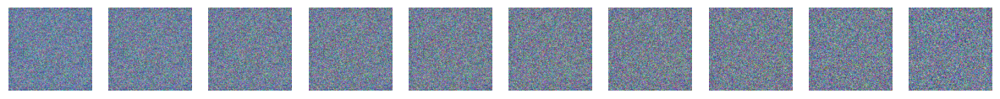

Epoch 0 | Step 100 | Loss: 0.15945479273796082 


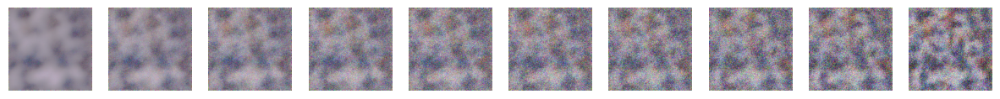

Epoch 0 | Step 200 | Loss: 0.12028490006923676 


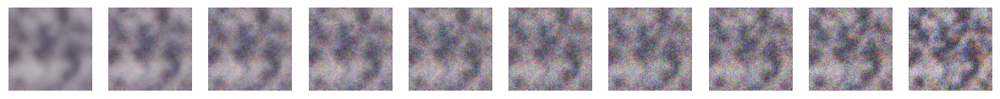

Model saved at epoch 0
Epoch 1 | Step 000 | Loss: 0.12646842002868652 


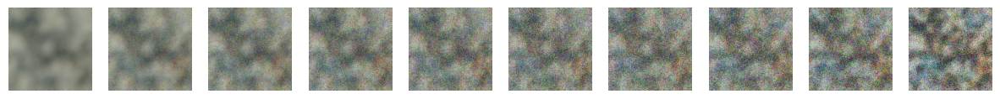

Epoch 1 | Step 100 | Loss: 0.10675456374883652 


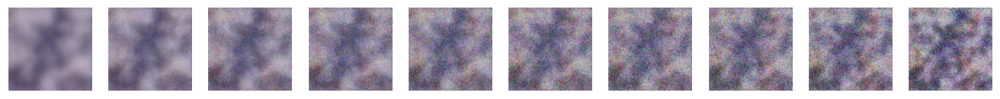

Epoch 1 | Step 200 | Loss: 0.10879148542881012 


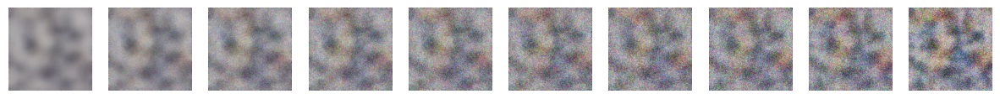

Model saved at epoch 1
Epoch 2 | Step 000 | Loss: 0.11402901262044907 


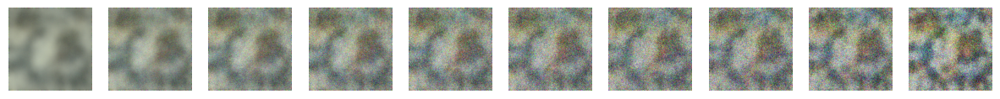

Epoch 2 | Step 100 | Loss: 0.1157836839556694 


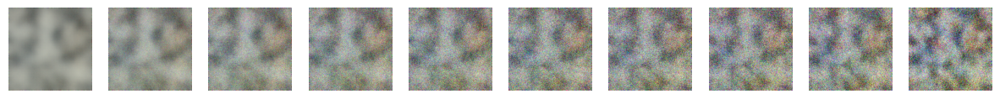

Epoch 2 | Step 200 | Loss: 0.10626739263534546 


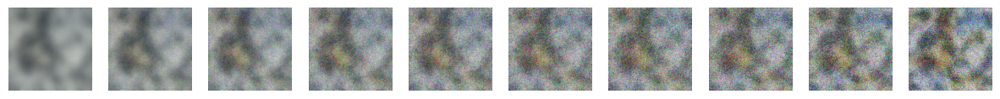

Model saved at epoch 2
Epoch 3 | Step 000 | Loss: 0.1154705286026001 


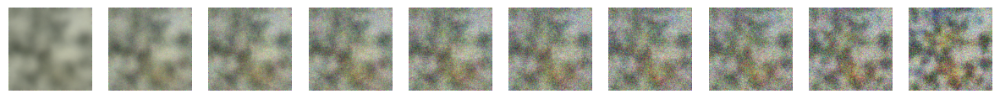

Epoch 3 | Step 100 | Loss: 0.10792984813451767 


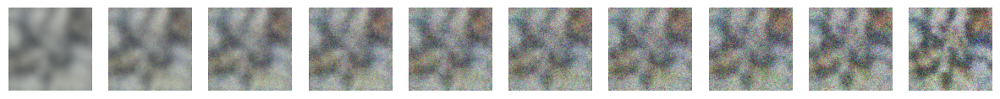

Epoch 3 | Step 200 | Loss: 0.11318417638540268 


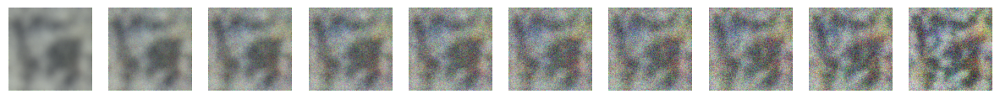

Model saved at epoch 3
Epoch 4 | Step 000 | Loss: 0.10180085897445679 


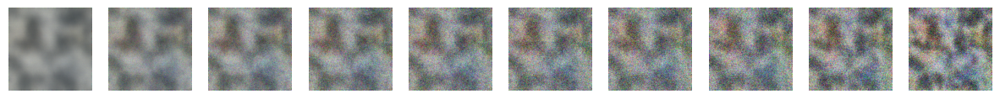

Epoch 4 | Step 100 | Loss: 0.10269239544868469 


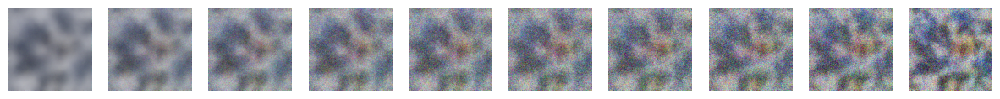

Epoch 4 | Step 200 | Loss: 0.096946582198143 


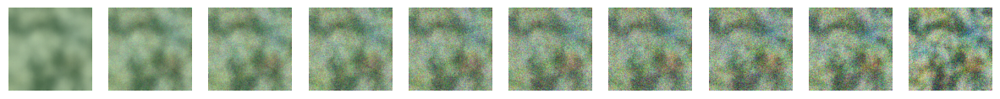

Model saved at epoch 4
Epoch 5 | Step 000 | Loss: 0.09852544963359833 


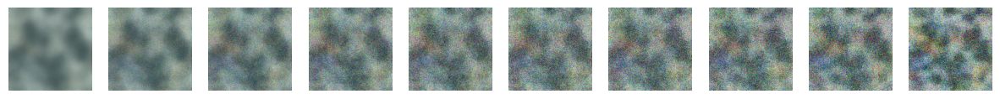

Epoch 5 | Step 100 | Loss: 0.10214100778102875 


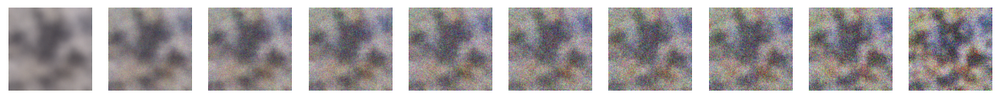

Epoch 5 | Step 200 | Loss: 0.09709783643484116 


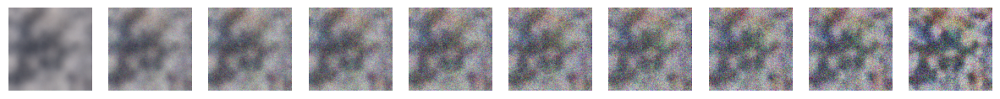

Model saved at epoch 5
Epoch 6 | Step 000 | Loss: 0.09927360713481903 


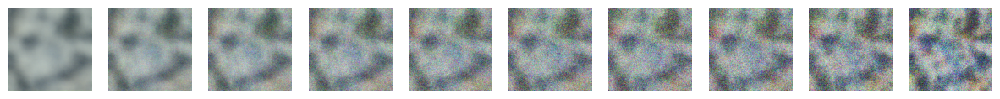

Epoch 6 | Step 100 | Loss: 0.09066848456859589 


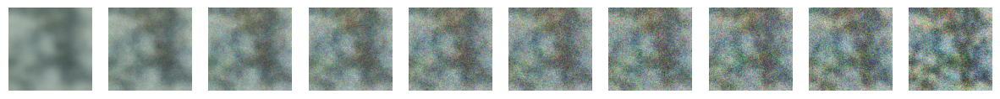

Epoch 6 | Step 200 | Loss: 0.09458461403846741 


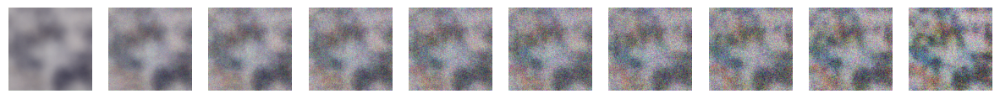

Model saved at epoch 6
Epoch 7 | Step 000 | Loss: 0.0934733971953392 


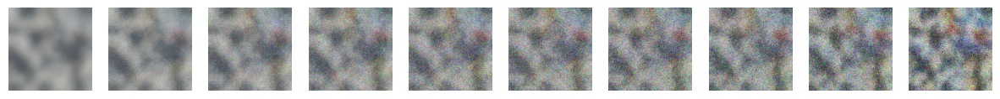

Epoch 7 | Step 100 | Loss: 0.09449295699596405 


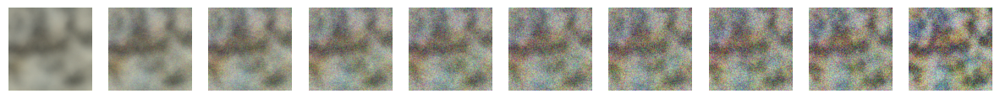

Epoch 7 | Step 200 | Loss: 0.10221050679683685 


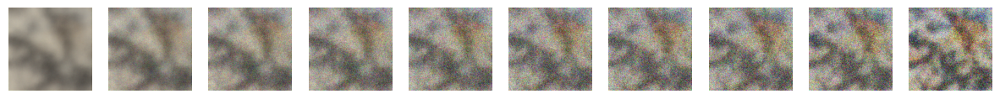

Model saved at epoch 7
Epoch 8 | Step 000 | Loss: 0.09960903972387314 


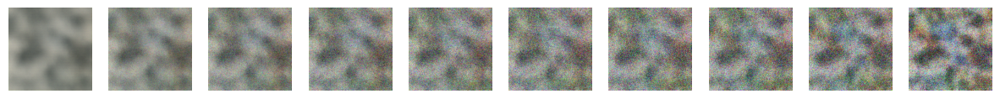

Epoch 8 | Step 100 | Loss: 0.09593387693166733 


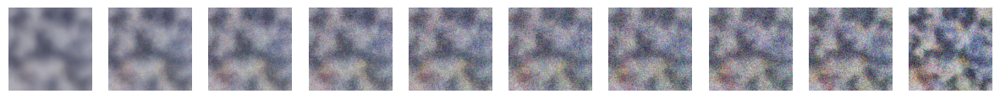

Epoch 8 | Step 200 | Loss: 0.08509914577007294 


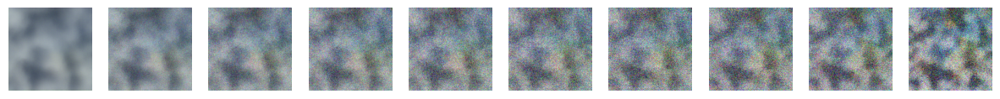

Model saved at epoch 8
Epoch 9 | Step 000 | Loss: 0.09330995380878448 


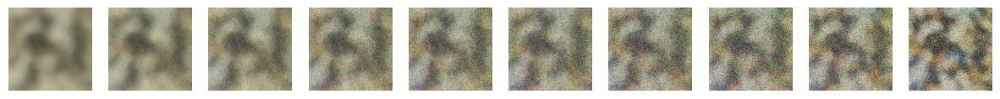

Epoch 9 | Step 100 | Loss: 0.0864940881729126 


/opt/conda/lib/python3.10/site-packages/matplotlib/cm.py:478: RuntimeWarning: invalid value encountered in cast

  xx = (xx * 255).astype(np.uint8)


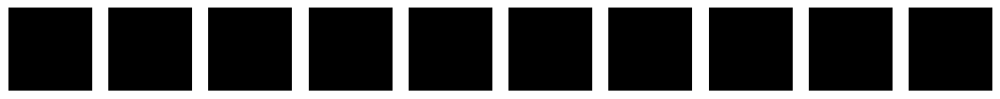

Epoch 9 | Step 200 | Loss: 0.09247168153524399 


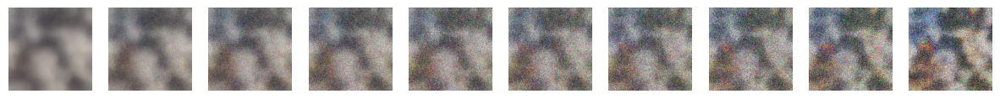

Model saved at epoch 9
Epoch 10 | Step 000 | Loss: 0.08850913494825363 


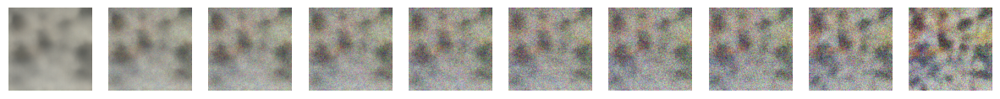

Epoch 10 | Step 100 | Loss: 0.08143699169158936 


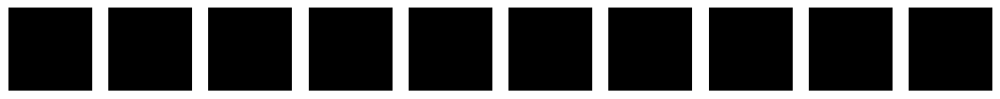

Epoch 10 | Step 200 | Loss: 0.09084721654653549 


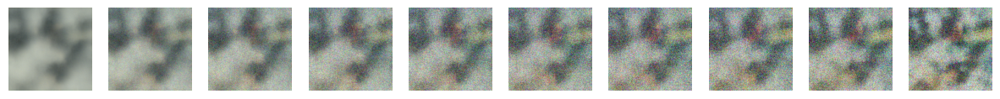

Model saved at epoch 10
Epoch 11 | Step 000 | Loss: 0.08280293643474579 


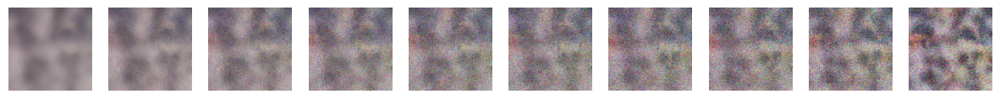

Epoch 11 | Step 100 | Loss: 0.08060711622238159 


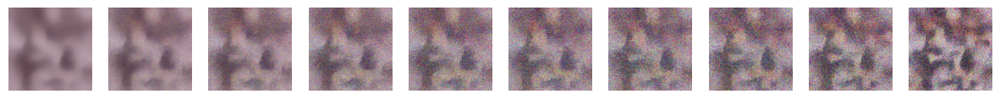

Epoch 11 | Step 200 | Loss: 0.08792458474636078 


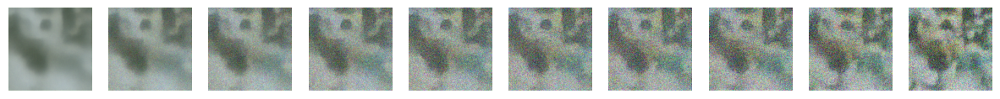

Model saved at epoch 11
Epoch 12 | Step 000 | Loss: 0.0888812392950058 


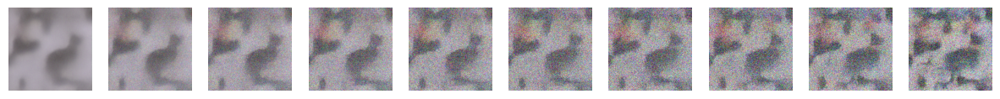

Epoch 12 | Step 100 | Loss: 0.07631386071443558 


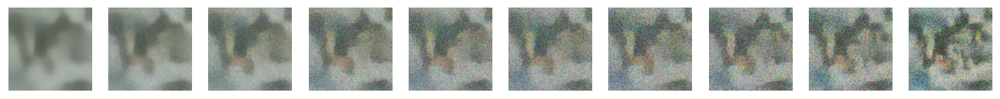

Epoch 12 | Step 200 | Loss: 0.07644651085138321 


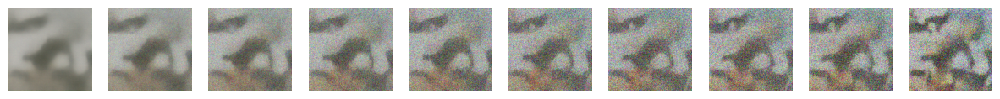

Model saved at epoch 12
Epoch 13 | Step 000 | Loss: 0.08762097358703613 


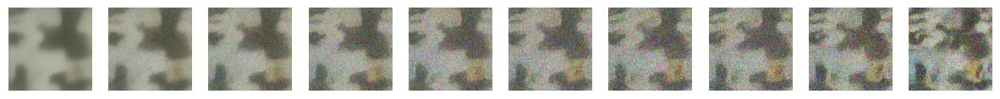

Epoch 13 | Step 100 | Loss: 0.07394799590110779 


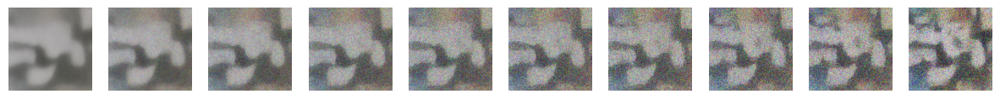

Epoch 13 | Step 200 | Loss: 0.07659241557121277 


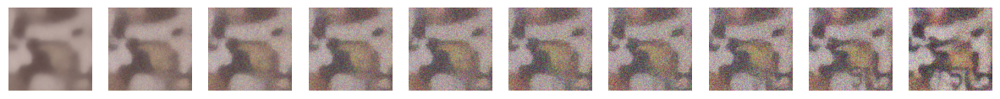

Model saved at epoch 13
Epoch 14 | Step 000 | Loss: 0.07319560647010803 


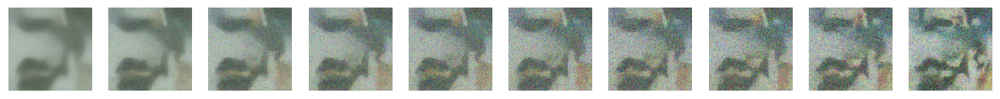

Epoch 14 | Step 100 | Loss: 0.07810819149017334 


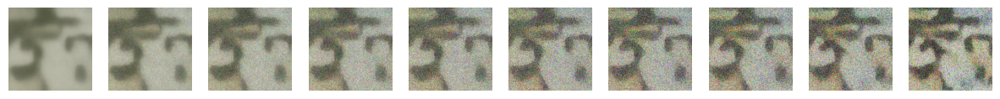

Epoch 14 | Step 200 | Loss: 0.07326750457286835 


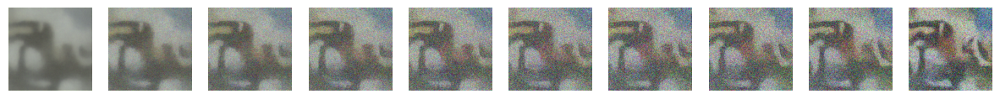

Model saved at epoch 14
Epoch 15 | Step 000 | Loss: 0.07691235840320587 


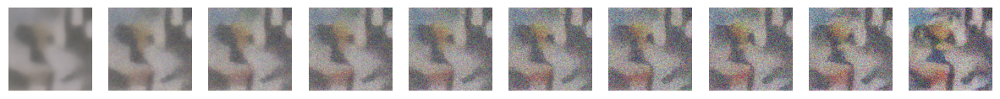

Epoch 15 | Step 100 | Loss: 0.0747685432434082 


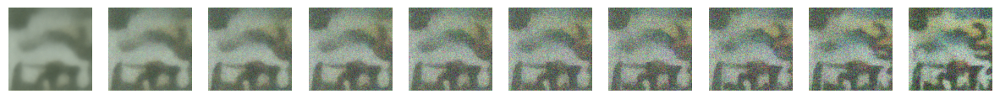

Epoch 15 | Step 200 | Loss: 0.0693303570151329 


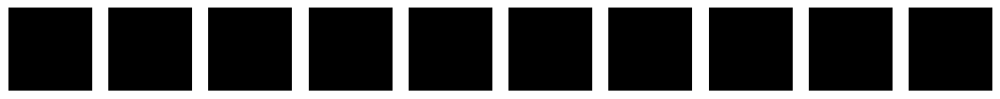

Model saved at epoch 15
Epoch 16 | Step 000 | Loss: 0.06949590891599655 


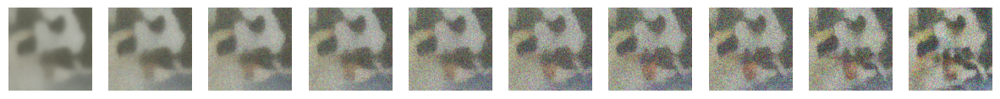

Epoch 16 | Step 100 | Loss: 0.07159196585416794 


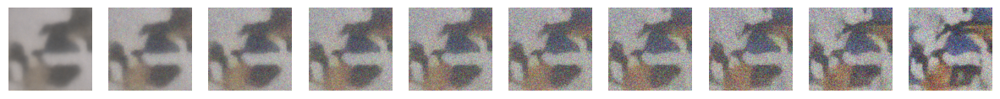

Epoch 16 | Step 200 | Loss: 0.06866028904914856 


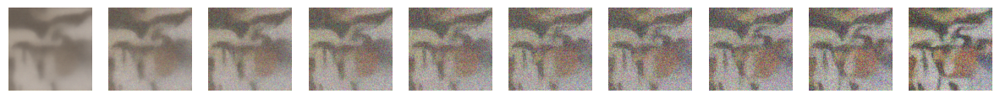

Model saved at epoch 16
Epoch 17 | Step 000 | Loss: 0.06770391762256622 


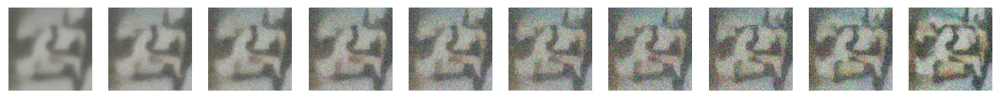

Epoch 17 | Step 100 | Loss: 0.0665757805109024 


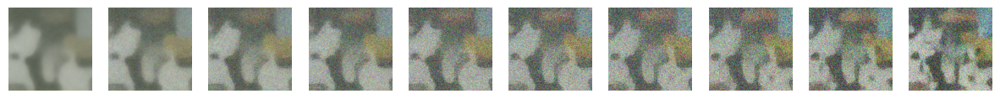

Epoch 17 | Step 200 | Loss: 0.07344329357147217 


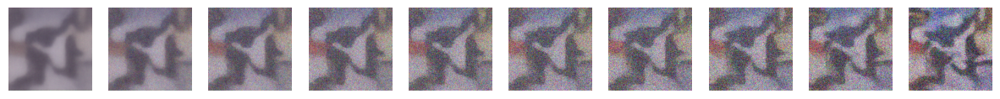

Model saved at epoch 17
Epoch 18 | Step 000 | Loss: 0.07344929873943329 


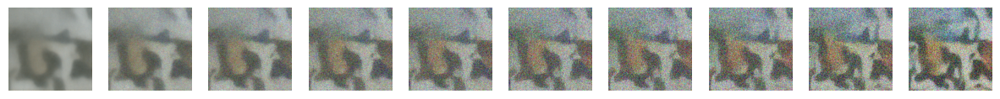

Epoch 18 | Step 100 | Loss: 0.06897103786468506 


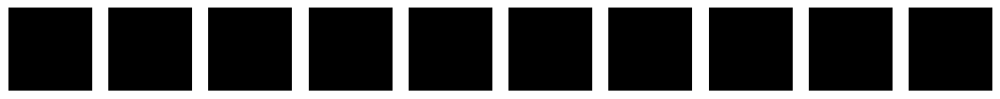

Epoch 18 | Step 200 | Loss: 0.07071205973625183 


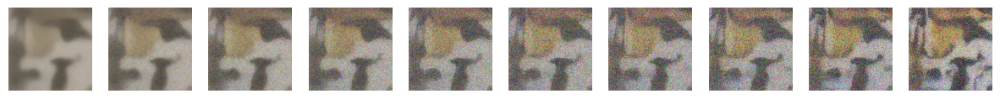

Model saved at epoch 18
Epoch 19 | Step 000 | Loss: 0.0682324469089508 


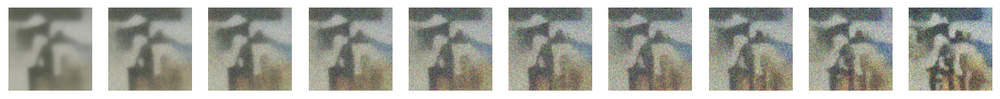

Epoch 19 | Step 100 | Loss: 0.06777053326368332 


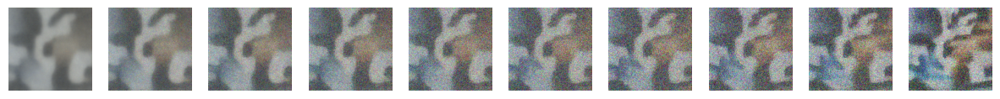

Epoch 19 | Step 200 | Loss: 0.07523226737976074 


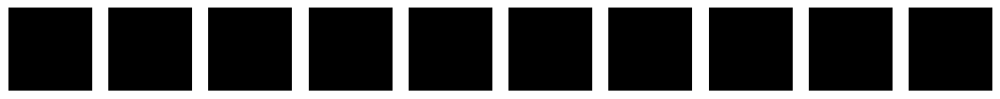

Model saved at epoch 19
Epoch 20 | Step 000 | Loss: 0.07415590435266495 


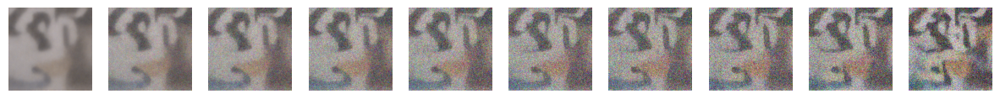

Epoch 20 | Step 100 | Loss: 0.06601472944021225 


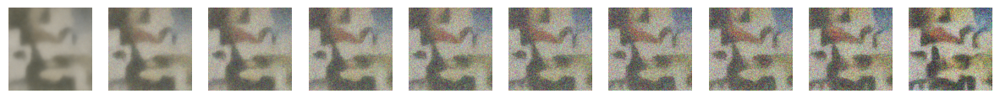

Epoch 20 | Step 200 | Loss: 0.06495323777198792 


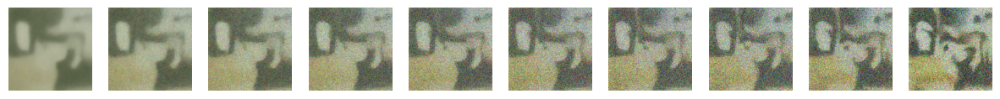

Model saved at epoch 20
Epoch 21 | Step 000 | Loss: 0.06591460108757019 


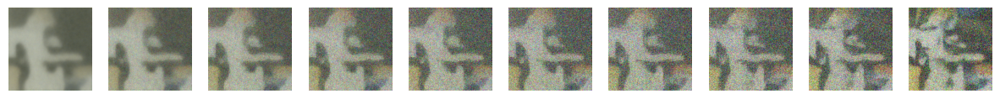

Epoch 21 | Step 100 | Loss: 0.08775411546230316 


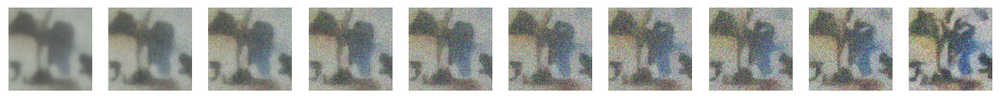

Epoch 21 | Step 200 | Loss: 0.07309959828853607 


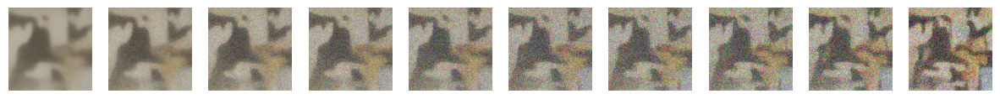

Model saved at epoch 21
Epoch 22 | Step 000 | Loss: 0.06802326440811157 


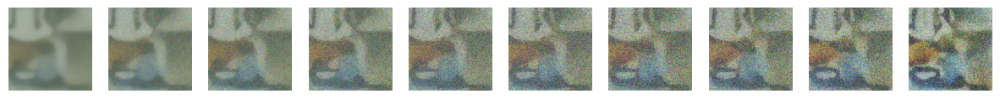

Epoch 22 | Step 100 | Loss: 0.06818963587284088 


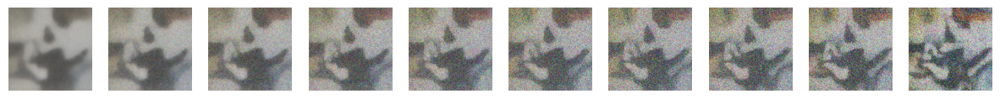

Epoch 22 | Step 200 | Loss: 0.07002107053995132 


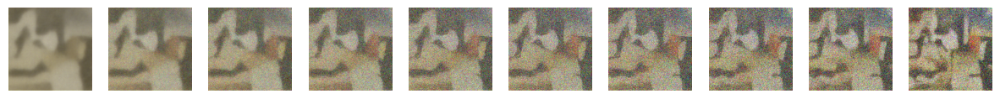

Model saved at epoch 22
Epoch 23 | Step 000 | Loss: 0.06572771072387695 


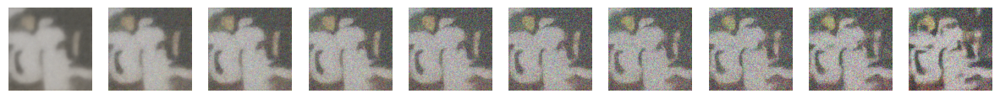

Epoch 23 | Step 100 | Loss: 0.0627555102109909 


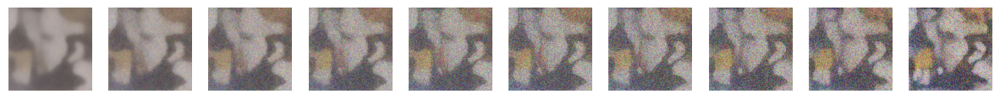

Epoch 23 | Step 200 | Loss: 0.06454101204872131 


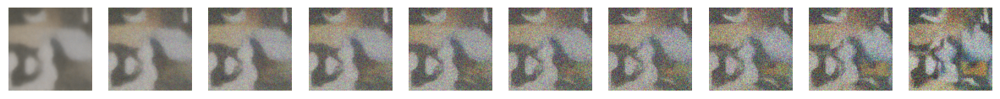

Model saved at epoch 23
Epoch 24 | Step 000 | Loss: 0.06645023822784424 


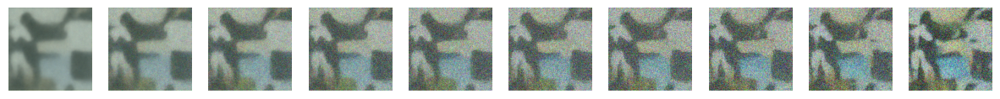

Epoch 24 | Step 100 | Loss: 0.0698229968547821 


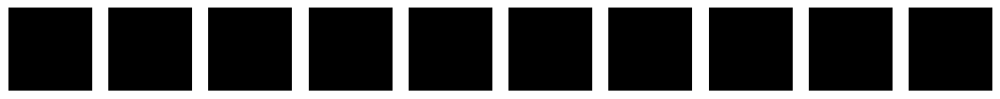

Epoch 24 | Step 200 | Loss: 0.06561516225337982 


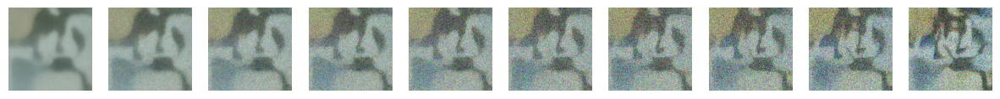

Model saved at epoch 24
Epoch 25 | Step 000 | Loss: 0.06484159082174301 


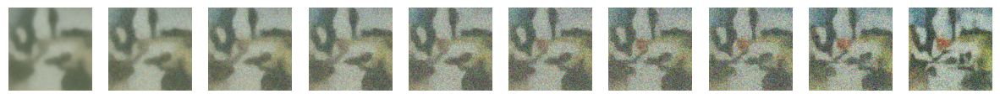

Epoch 25 | Step 100 | Loss: 0.06090250611305237 


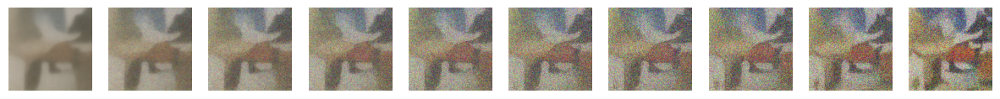

Epoch 25 | Step 200 | Loss: 0.06299950927495956 


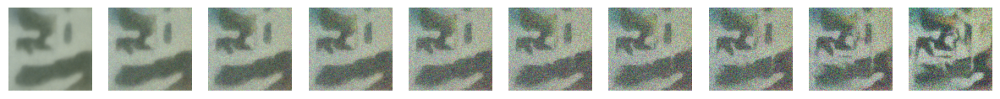

Model saved at epoch 25
Epoch 26 | Step 000 | Loss: 0.0695669949054718 


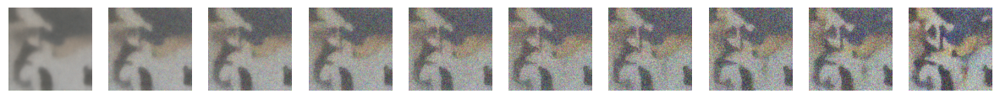

Epoch 26 | Step 100 | Loss: 0.06970870494842529 


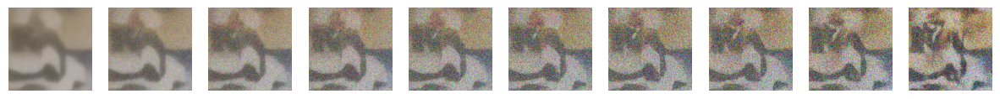

Epoch 26 | Step 200 | Loss: 0.0665428414940834 


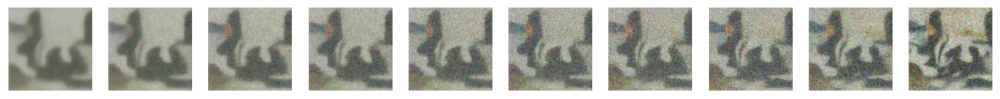

Model saved at epoch 26
Epoch 27 | Step 000 | Loss: 0.07425601780414581 


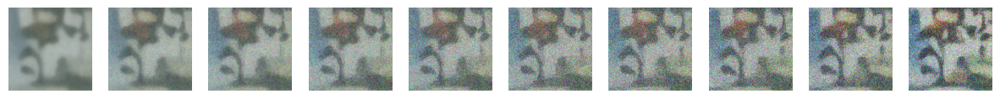

Epoch 27 | Step 100 | Loss: 0.06489395350217819 


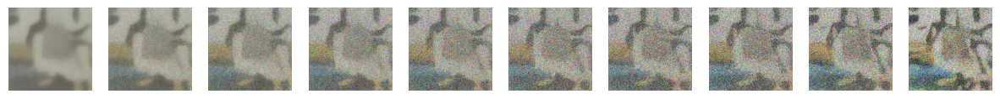

Epoch 27 | Step 200 | Loss: 0.06331630796194077 


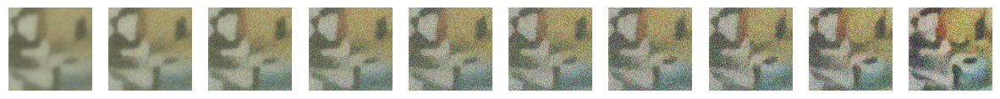

Model saved at epoch 27
Epoch 28 | Step 000 | Loss: 0.06597001850605011 


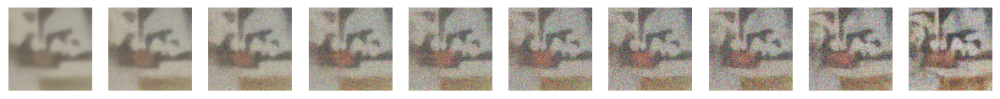

Epoch 28 | Step 100 | Loss: 0.06724786758422852 


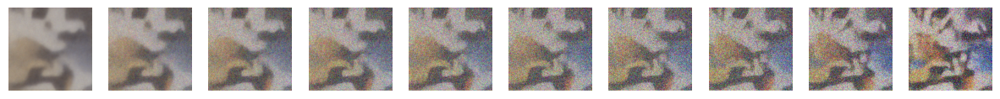

Epoch 28 | Step 200 | Loss: 0.06582777202129364 


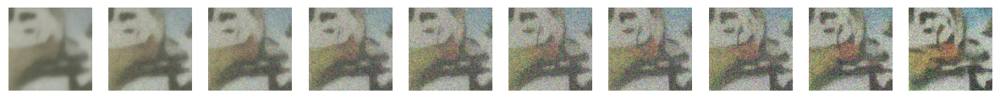

Model saved at epoch 28
Epoch 29 | Step 000 | Loss: 0.06572262942790985 


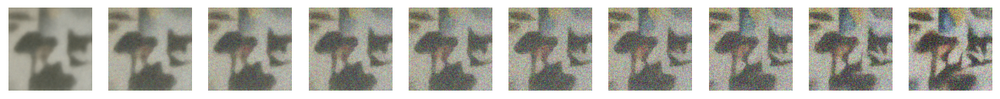

Epoch 29 | Step 100 | Loss: 0.07165147364139557 


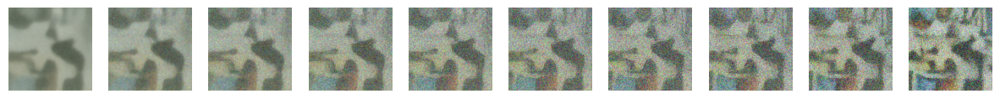

Epoch 29 | Step 200 | Loss: 0.06843353807926178 


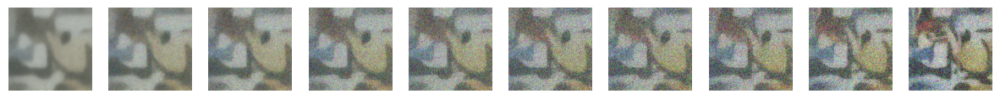

Model saved at epoch 29
Epoch 30 | Step 000 | Loss: 0.06656800210475922 


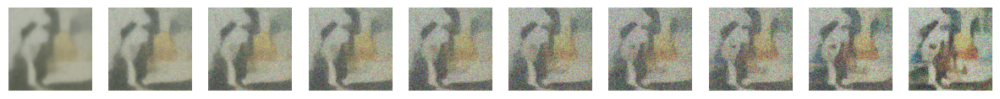

Epoch 30 | Step 100 | Loss: 0.0658411979675293 


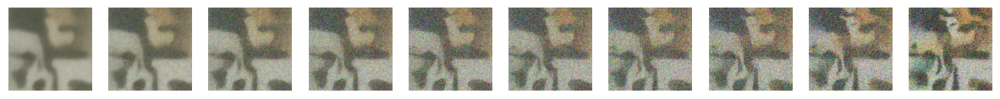

Epoch 30 | Step 200 | Loss: 0.0642961785197258 


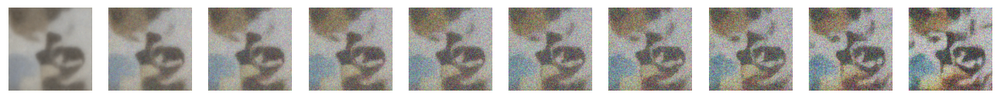

Model saved at epoch 30
Epoch 31 | Step 000 | Loss: 0.06352125108242035 


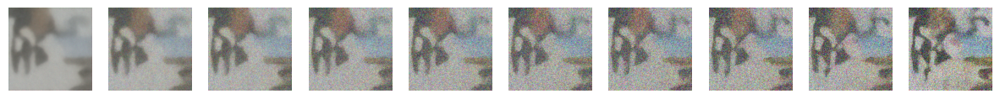

Epoch 31 | Step 100 | Loss: 0.06680747866630554 


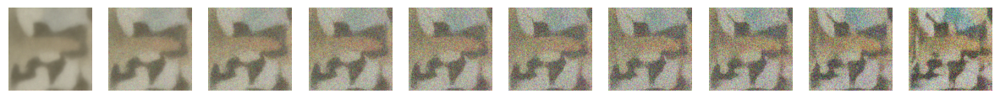

Epoch 31 | Step 200 | Loss: 0.06460709869861603 


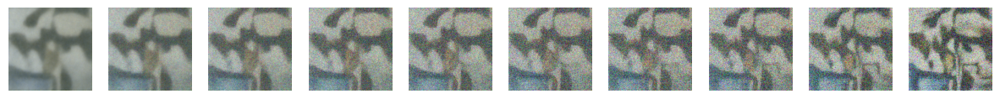

Model saved at epoch 31
Epoch 32 | Step 000 | Loss: 0.06351110339164734 


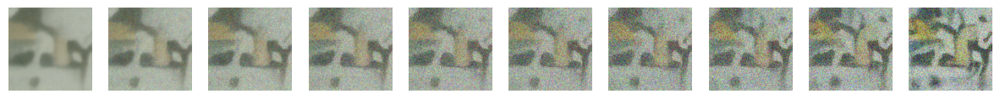

Epoch 32 | Step 100 | Loss: 0.07253848016262054 


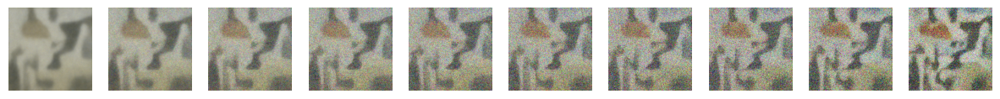

Epoch 32 | Step 200 | Loss: 0.06301701068878174 


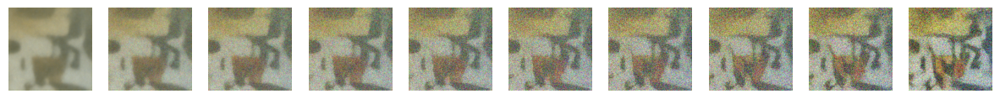

Model saved at epoch 32
Epoch 33 | Step 000 | Loss: 0.062267668545246124 


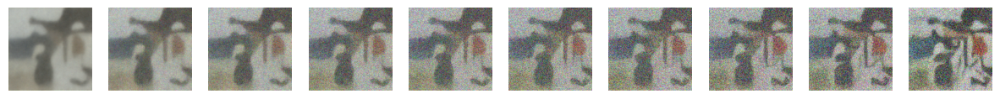

Epoch 33 | Step 100 | Loss: 0.0638006329536438 


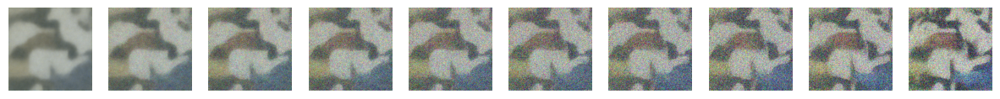

Epoch 33 | Step 200 | Loss: 0.06676025688648224 


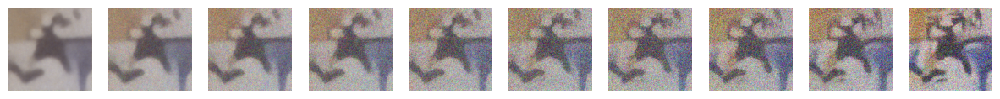

Model saved at epoch 33
Epoch 34 | Step 000 | Loss: 0.06568578630685806 


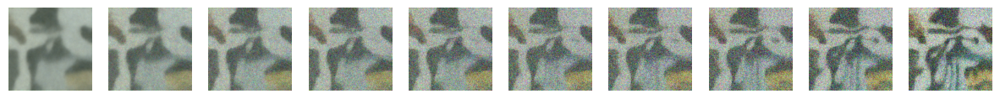

Epoch 34 | Step 100 | Loss: 0.06743411719799042 


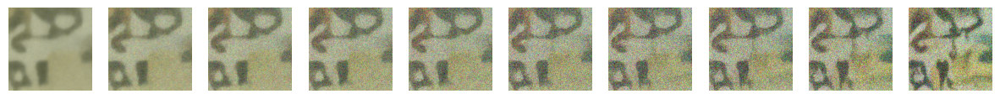

Epoch 34 | Step 200 | Loss: 0.06391476094722748 


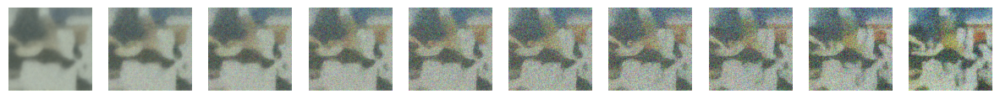

Model saved at epoch 34
Epoch 35 | Step 000 | Loss: 0.0684400126338005 


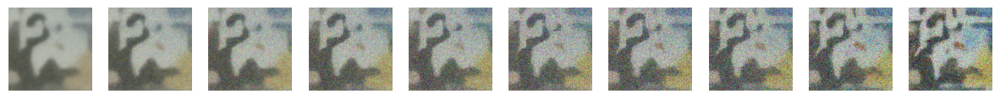

Epoch 35 | Step 100 | Loss: 0.06877315044403076 


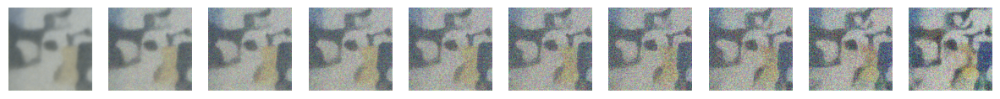

Epoch 35 | Step 200 | Loss: 0.06460490822792053 


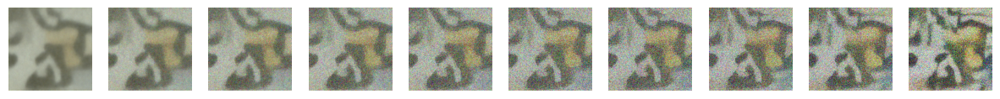

Model saved at epoch 35
Epoch 36 | Step 000 | Loss: 0.0640639066696167 


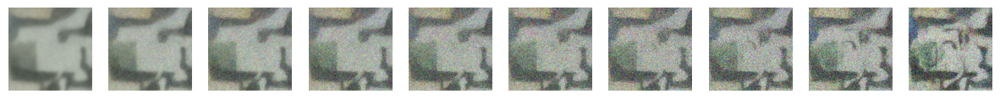

Epoch 36 | Step 100 | Loss: 0.06480512022972107 


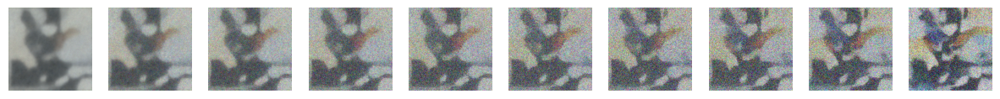

Epoch 36 | Step 200 | Loss: 0.06568737328052521 


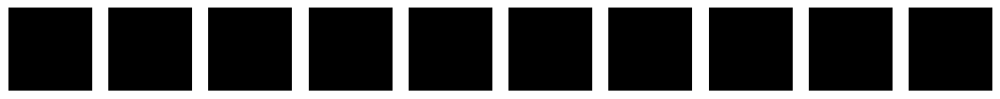

Model saved at epoch 36
Epoch 37 | Step 000 | Loss: 0.06364862620830536 


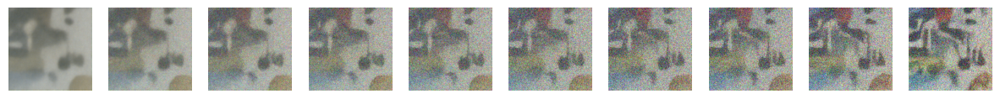

Epoch 37 | Step 100 | Loss: 0.06588991731405258 


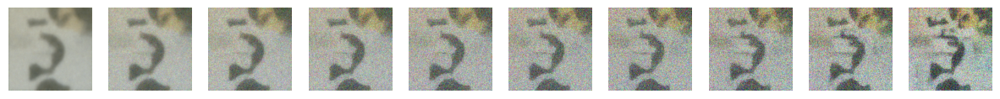

Epoch 37 | Step 200 | Loss: 0.0608944371342659 


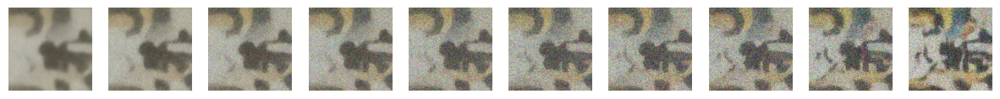

Model saved at epoch 37
Epoch 38 | Step 000 | Loss: 0.06142004579305649 


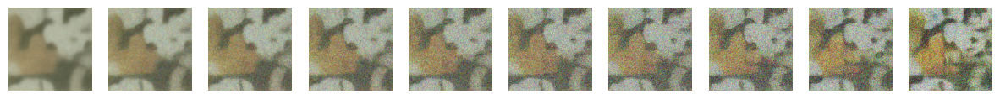

Epoch 38 | Step 100 | Loss: 0.06440078467130661 


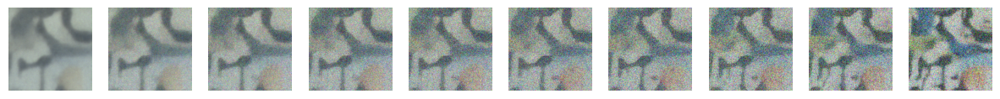

Epoch 38 | Step 200 | Loss: 0.06443341076374054 


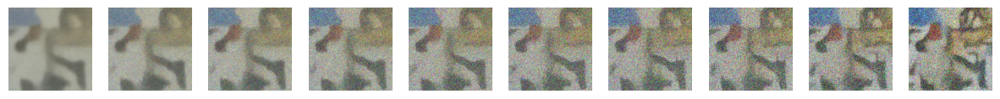

Model saved at epoch 38
Epoch 39 | Step 000 | Loss: 0.06846408545970917 


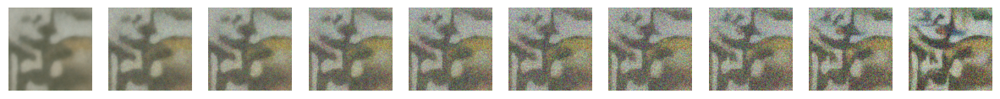

Epoch 39 | Step 100 | Loss: 0.06655842810869217 


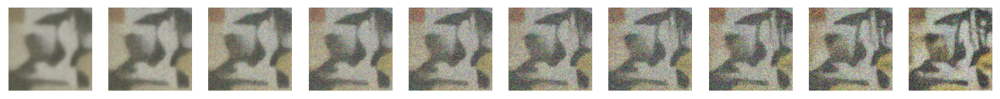

Epoch 39 | Step 200 | Loss: 0.06604012846946716 


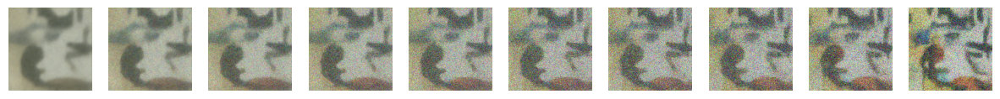

Model saved at epoch 39
Epoch 40 | Step 000 | Loss: 0.06300485134124756 


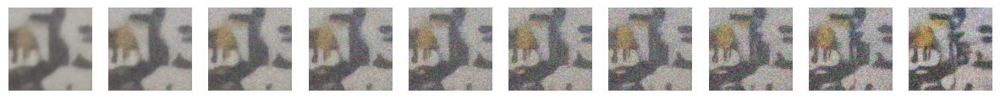

Epoch 40 | Step 100 | Loss: 0.06337670981884003 


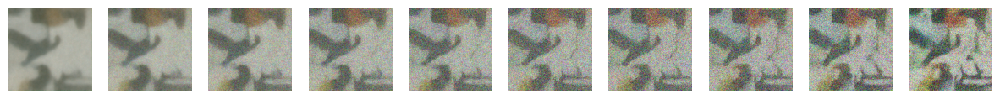

Epoch 40 | Step 200 | Loss: 0.06380860507488251 


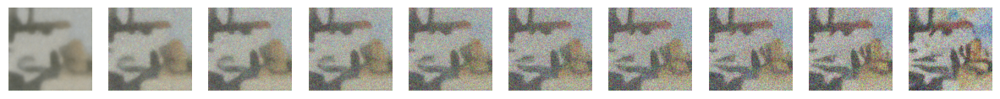

Model saved at epoch 40
Epoch 41 | Step 000 | Loss: 0.06473883986473083 


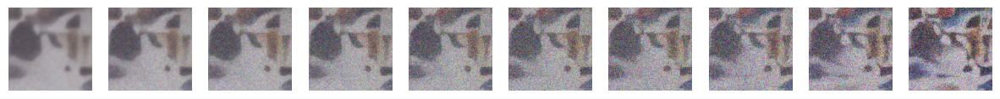

Epoch 41 | Step 100 | Loss: 0.06324079632759094 


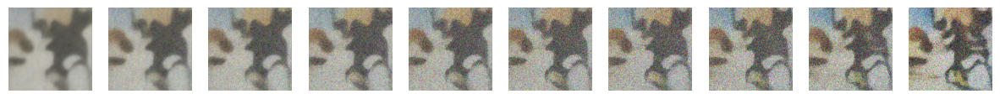

Epoch 41 | Step 200 | Loss: 0.06521867960691452 


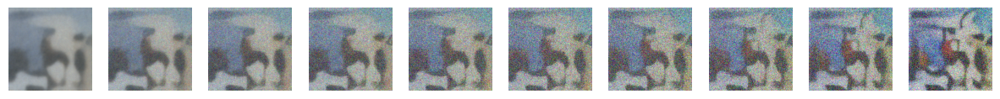

Model saved at epoch 41
Epoch 42 | Step 000 | Loss: 0.0667312890291214 


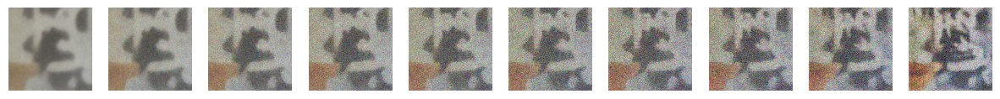

Epoch 42 | Step 100 | Loss: 0.06596347689628601 


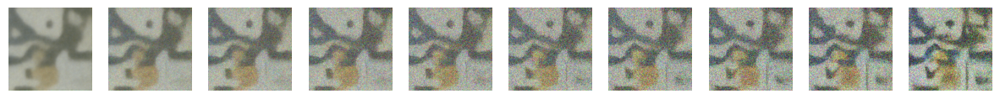

Epoch 42 | Step 200 | Loss: 0.06376829743385315 


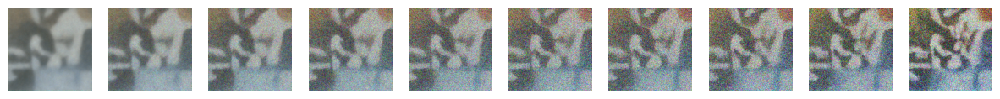

Model saved at epoch 42
Epoch 43 | Step 000 | Loss: 0.06677253544330597 


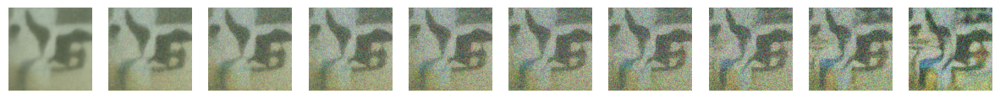

Epoch 43 | Step 100 | Loss: 0.06324654817581177 


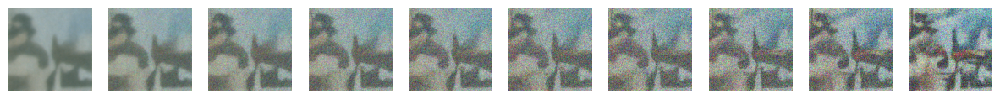

Epoch 43 | Step 200 | Loss: 0.06157159432768822 


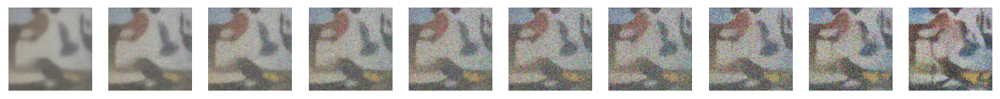

Model saved at epoch 43
Epoch 44 | Step 000 | Loss: 0.06310227513313293 


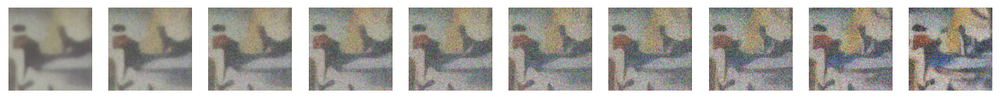

Epoch 44 | Step 100 | Loss: 0.06470587849617004 


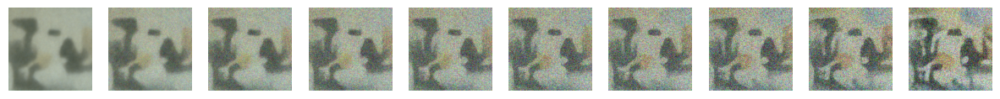

Epoch 44 | Step 200 | Loss: 0.061160482466220856 


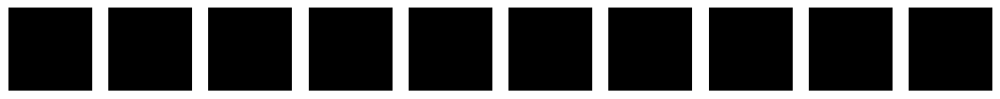

Model saved at epoch 44
Epoch 45 | Step 000 | Loss: 0.062473803758621216 


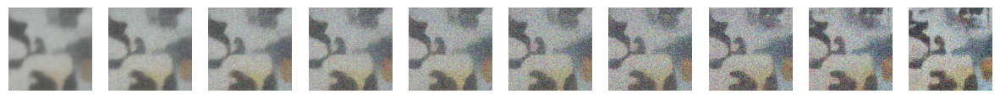

Epoch 45 | Step 100 | Loss: 0.0699111819267273 


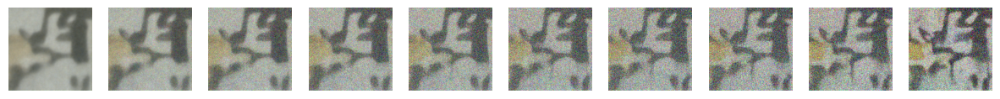

Epoch 45 | Step 200 | Loss: 0.06551352143287659 


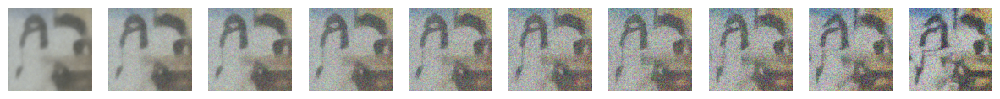

Model saved at epoch 45
Epoch 46 | Step 000 | Loss: 0.06470950692892075 


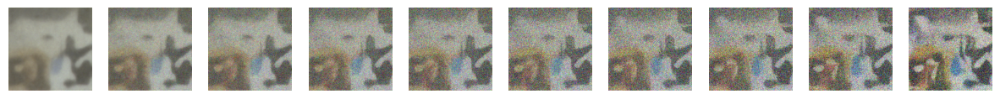

Epoch 46 | Step 100 | Loss: 0.06648032367229462 


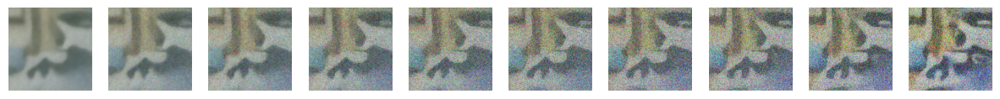

Epoch 46 | Step 200 | Loss: 0.06268490105867386 


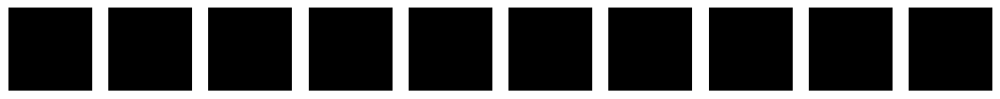

Model saved at epoch 46
Epoch 47 | Step 000 | Loss: 0.06754927337169647 


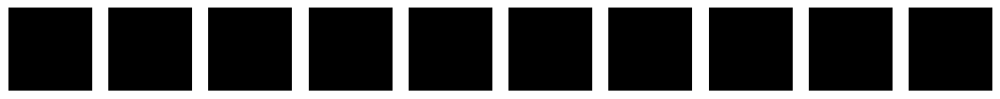

Epoch 47 | Step 100 | Loss: 0.06310542672872543 


In [10]:
# Training loop
for epoch in range(num_epochs):
    for step, batch in enumerate(train_dataloader):
        optimizer.zero_grad()
        timesteps = torch.randint(0, num_timesteps, (BATCH_SIZE,), device=device).long()  # Random timesteps for each batch
        if batch['image'].size() != BATCH_SIZE:
            timesteps = torch.randint(0, num_timesteps, (batch['image'].size()[0],), device=device).long()

        batch['image'] = batch['image'].to(device)  # Ensure batch['image'] is on the correct device
        with torch.cuda.amp.autocast():
            loss = compute_loss(model, batch['image'], timesteps)

        scaler.scale(loss).backward()  # Scale loss and perform backpropagation
        scaler.step(optimizer)  # Step optimizer
        scaler.update()  # Update scaler

        if step % 100 == 0:
            print(f"Epoch {epoch} | Step {step:03d} | Loss: {loss.item()} ")  # Print loss every 100 steps
            plot_sampled_images()  # Plot sampled images
        
    # Save the model at the end of each epoch
    torch.save(model.state_dict(), save_path)
    print(f"Model saved at epoch {epoch}")

### Clear GPU Cache

In [ ]:
torch.cuda.empty_cache() # Clear GPU cache